In [1]:
using DifferentialEquations
using Statistics
using Trapz
using Plots
using DelimitedFiles
using StaticArrays
using LinearAlgebra
using LogExpFunctions
using NaNMath; nm=NaNMath
using ProgressMeter
using LaTeXStrings
using FFTW

In [2]:
################################################################################
# Import required packages
using OrdinaryDiffEq       # For ODE solvers
using Plots                # For plotting heatmaps and GIF creation
using HDF5                 # For saving data in HDF5 files
using Statistics           # For mean and variance computations
using Dates                # For timestamps
using FileIO               # (for file management if needed)


################################################################################
# Define fixed parameters (except Omega, V and Gamma, which will be overwritten)
base_params = (
    kappa  = 1.0,
    gamma  = 1.0,     # used also as g₀ in the analytical boundary expression
    Gamma  = 1.0,     # will be overwritten by gamma_range value
    Omega  = 8.0,     # initial value (will be overwritten in the parameter scan)
    delta1 = 1.0,
    delta2 = 1.0,
    eta    = 1.0,
    V      = -8.0     # initial value (will be overwritten in the parameter scan)
)

################################################################################
# Define time span for the simulation
t0 = 0.0
t_end = 2000.0
tspan = (t0, t_end)


function rhs_dgl(y, params)
    # Unpack state vector
    a          = y[1]
    a_dagger   = y[2]
    ket00      = y[3]
    ket01      = y[4]
    ket10      = y[5]
    ket11      = y[6]
    ket22      = y[7]
    ket21      = y[8]
    ket12      = y[9]
    ket20      = y[10]
    ket02      = y[11]

    # Unpack parameters
    κ     = params.kappa     # e.g. 1.0
    γ     = params.gamma     # e.g. 1.0 (used as g₀ for the analytical boundary)
    Γ     = params.Gamma     # overwritten by gamma_range value
    Ω     = params.Omega     # overwritten in the parameter scan
    ketdelta1    = params.delta1    # e.g. 1.0
    ketdelta2    = params.delta2    # e.g. 1.0
    η     = params.eta       # e.g. 1.0
    V     = params.V         # overwritten in the parameter scan

    # Define the ODE system
    da_dt          = -κ/2 * a - 1im*(γ*ket01) + η
    da_dagger_dt   = conj(da_dt)

    dket00_dt      = Γ*ket11 + 1im*γ*(ket10*a - ket01*a_dagger)
    dket01_dt      = -Γ/2 * ket01 + 1im*(-ketdelta1*ket01 + γ*(ket11*a - ket00*a) - Ω/2*ket02)
    dket10_dt      = conj(dket01_dt)

    dket11_dt      = -Γ*ket11 + 1im*γ*(ket01*a_dagger - ket10*a) + 1im*(Ω/2)*(ket21 - ket12)
    dket22_dt      = 1im*(Ω/2)*(ket12 - ket21)

    dket21_dt      = -Γ/2 * ket21 + 1im*(ketdelta2*ket21 - ketdelta1*ket21 - γ*ket20*a + (Ω/2)*(ket11 - ket22) + 2*V*ket21*ket22)
    dket12_dt      = conj(dket21_dt)

    dket02_dt      = 1im*(-ketdelta2*ket02 - Ω/2*ket01 - 2*V*ket02*ket22 + γ*ket12*a)
    dket20_dt      = conj(dket02_dt)

    return [
        da_dt,
        da_dagger_dt,
        dket00_dt,
        dket01_dt,
        dket10_dt,
        dket11_dt,
        dket22_dt,
        dket21_dt,
        dket12_dt,
        dket20_dt,
        dket02_dt
    ]
end


rhs_dgl (generic function with 1 method)

In [29]:
using DifferentialEquations, LinearAlgebra

# --- 1) RHS-Funktion ---
function rhs_gellmann_qp_from_ket(y, params)
    # unpack field mode and density-matrix elements
    a        = y[1]
    a_dagger = y[2]
    ket00    = y[3]
    ket01    = y[4]
    ket10    = y[5]
    ket11    = y[6]
    ket22    = y[7]
    ket21    = y[8]
    ket12    = y[9]
    ket20    = y[10]
    ket02    = y[11]

    # unpack parameters
    κ   = params.kappa
    γ   = params.gamma
    Γ   = params.Gamma
    Ω   = params.Omega
    delta1  = params.delta1
    delta2 = params.delta2
    η   = params.eta
    V   = params.V

    # --- original ODEs for a and ρ_ij ---
    da_dt          = -κ/2 * a - 1im*(γ*ket01) + η
    da_dagger_dt   = conj(da_dt)

    dket00_dt      = Γ*ket11 + 1im*γ*(ket10*a - ket01*a_dagger)
    dket01_dt      = -Γ/2 * ket01 + 1im*(-delta1*ket01 + γ*(ket11*a - ket00*a) - Ω/2*ket02)
    dket10_dt      = conj(dket01_dt)

    dket11_dt      = -Γ*ket11 + 1im*γ*(ket01*a_dagger - ket10*a) + 1im*(Ω/2)*(ket21 - ket12)
    dket22_dt      = 1im*(Ω/2)*(ket12 - ket21)

    dket21_dt      = -Γ/2 * ket21 + 1im*(delta2*ket21 - delta1*ket21 - γ*ket20*a + (Ω/2)*(ket11 - ket22) + 2*V*ket21*ket22)
    dket12_dt      = conj(dket21_dt)

    dket02_dt      = 1im*(-delta2*ket02 - Ω/2*ket01 - 2*V*ket02*ket22 + γ*ket12*a)
    dket20_dt      = conj(dket02_dt)

            # --- compute Gell-Mann expectations x_i = Tr[ρ λ_i] ---
    dx1 =  dket01_dt + dket10_dt
    dx2 = -im*dket01_dt + im*dket10_dt
    dx3 =  dket00_dt - dket11_dt
    dx4 =  dket02_dt + dket20_dt
    dx5 = -im*dket02_dt + im*dket20_dt
    dx6 =  dket12_dt + dket21_dt
    dx7 = -im*dket12_dt + im*dket21_dt
    dx8 = (dket00_dt + dket11_dt - 2*dket22_dt)/√3

    # --- compute quadrature derivatives ---
    dq_dt = (da_dt + da_dagger_dt)/√2
    dp_dt = (da_dt - da_dagger_dt)/(im*√2)

    return [
        da_dt,
        da_dagger_dt,
        dket00_dt,
        dket01_dt,
        dket10_dt,
        dket11_dt,
        dket22_dt,
        dket21_dt,
        dket12_dt,
        dket20_dt,
        dket02_dt
    ]

end

function rhs_gellmann_qp_from_x(x, params)
    # unpack quadratures & Gell-Mann components
    Q, P, x1, x2, x3, x4, x5, x6, x7, x8 = x

    # reconstruct field mode
    a        = (Q + im * P) / √2
    a_dagger = conj(a)

    # reconstruct density-matrix
    sum00_11 = (2 + √3 * x8) / 3
    rho00    = (sum00_11 + x3) / 2
    rho11    = (sum00_11 - x3) / 2
    rho22    = 1 - rho00 - rho11

    rho01 = (x1 + im*x2) / 2
    rho02 = (x4 + im*x5) / 2
    rho12 = (x6 + im*x7) / 2

    rho10, rho20, rho21 = conj(rho01), conj(rho02), conj(rho12)

    # pack into y für deine ket-Funktion
    y = ComplexF64[
        a, a_dagger,
        rho00, rho01, rho10, rho11, rho22, rho21, rho12, rho20, rho02
    ]

    # call original RHS (returns ComplexF64-Derivs)
    dy = rhs_gellmann_qp_from_ket(y, params)

    # unpack dy
    da_dt, da_dagger_dt = dy[1], dy[2]
    d00, d01, d10, d11 = dy[3], dy[4], dy[5], dy[6]
    d22, d21, d12, d20, d02 = dy[7], dy[8], dy[9], dy[10], dy[11]

    # compute dx
    dx1 =  d01 + d10
    dx2 = -im*d01 + im*d10
    dx3 =  d00 - d11
    dx4 =  d02 + d20
    dx5 = -im*d02 + im*d20
    dx6 =  d12 + d21
    dx7 = -im*d12 + im*d21
    dx8 = (d00 + d11 - 2*d22) / √3

    # quadrature derivatives
    dQ = (da_dt + da_dagger_dt) / √2
    dP = (da_dt - da_dagger_dt) / (im*√2)

    return ComplexF64[dQ, dP, dx1, dx2, dx3, dx4, dx5, dx6, dx7, dx8]
end

function convert_state(y::AbstractVector{<:ComplexF64})
    if length(y) == 11
        # --- full → projected ---
        # unpack ladder expectations
        a, ad = y[1], y[2]
        # unpack density matrix elements
        ρ00, ρ01, ρ10, ρ11, ρ22, ρ21, ρ12, ρ02, ρ20 = y[3:end]
        # compute Gell-Mann coefficients
        x1 = ρ01 + ρ10
        x2 = -im*(ρ01 - ρ10)
        x3 = ρ00 - ρ11
        x4 = ρ02 + ρ20
        x5 = -im*(ρ02 - ρ20)
        x6 = ρ12 + ρ21
        x7 = -im*(ρ12 - ρ21)
        x8 = (ρ00 + ρ11 - 2ρ22) / sqrt(3)
        # compute quadratures
        Q = (a + ad) / sqrt(2)
        P = (a - ad) / (im * sqrt(2))
        # return 10-vector
        return ComplexF64[Q, P,x1, x2, x3, x4, x5, x6, x7, x8]

    elseif length(y) == 10
        # --- projected → full ---
        # unpack Gell-Mann and quadratures
        x1, x2, x3, x4, x5, x6, x7, x8, Q, P = y
        # reconstruct ladder expectations
        a  = (Q + im*P) / sqrt(2)
        ad = (Q - im*P) / sqrt(2)
        # reconstruct density matrix diagonal
        ρ00 = 1/3 + 0.5*( x3 + x8/sqrt(3) )
        ρ11 = 1/3 + 0.5*(-x3 + x8/sqrt(3))
        ρ22 = 1/3 -      x8/sqrt(3)
        # reconstruct density matrix off-diagonals
        ρ01 = (x1 + im*x2) / 2
        ρ10 = conj(ρ01)
        ρ02 = (x4 + im*x5) / 2
        ρ20 = conj(ρ02)
        ρ12 = (x6 + im*x7) / 2
        ρ21 = conj(ρ12)
        # return 11-vector
        return ComplexF64[a, ad,
                          ρ00, ρ01, ρ10, ρ11, ρ22, ρ21, ρ12, ρ02, ρ20]

    else
        error("Input vector must have length 10 or 11, got length = $(length(y))")
    end
end

convert_state (generic function with 1 method)

In [ ]:
#print(convert_state([0.0+0im, 0.0+0im, 1.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im]))

current_params=(
    kappa  = 1.0,
    gamma  = 1.0,     # used also as g₀ in the analytical boundary expression
    Gamma  = 1.0,     # will be overwritten by gamma_range value
    Omega  = 8.0,     # initial value (will be overwritten in the parameter scan)
    delta1 = 1.0,
    delta2 = 1.0,
    eta    = 1.0,
    V      = -8.0     # initial value (will be overwritten in the parameter scan)
)
# Define time span for the simulation
t0 = 0.0
t_end = 2000.0
tspan = (t0, t_end)

################################################################################
# Define simulation initial conditions (state vector with 11 components)
# Simulation 1: All zeros except ψ₀₀ = 1 (Index 3)


y0 = [0.0+0im, 0.0+0im, 1.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im] #rho_00=1
#y0 = [0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 1.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im] #rho_11=1
#y0 = [0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im,0.0+0im, 1.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im] #rho_22=1
y0_gell=convert_state(y0)
# gellman output
prob = ODEProblem((y, p, t) -> rhs_gellmann_qp_from_x(y, p), y0_gell, tspan, current_params)
sol = solve(prob, Tsit5(); abstol=1e-8, reltol=1e-8)
# rho output
# prob = ODEProblem((y, p, t) -> rhs_gellmann_qp_from_ket(y, p), y0, tspan, current_params)
# sol = solve(prob, Tsit5(); abstol=1e-8, reltol=1e-8)

retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 108145-element Vector{Float64}:
    0.0
    0.004723515201696694
    0.00812361848417701
    0.012944294960494557
    0.017652448611739396
    0.023041355996944134
    0.028616839611196314
    0.034579097735613254
    0.040765120655779405
    0.047211421210490045
    ⋮
 1999.8674158298606
 1999.8859052853097
 1999.9042489265078
 1999.9224009463599
 1999.9403454013793
 1999.9580871325275
 1999.9756457255587
 1999.9930509251033
 2000.0
u: 108145-element Vector{Vector{ComplexF64}}:
 [0.0 + 0.0im, 0.0 - 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, -1.1547005383792517 + 0.0im]
 [0.0066721771299322686 + 0.0im, 2.4256833992279823e-14 + 0.0im, -4.378379283530432e-11 + 0.0im, 5.286498536533651e-9 + 0.0im, -0.00035537089163586484 + 0.0im, -2.801375087510232e-7 + 0.0im, -1.290818171943639e-8 + 0.0im, -0.0014245941356845193 + 0.0im, 0.03769867459724258 + 0.0im, -1.1540

In [5]:
# current_params=(
#     kappa  = 1.0,
#     gamma  = 1.0,     # used also as g₀ in the analytical boundary expression
#     Gamma  = 1.0,     # will be overwritten by gamma_range value
#     Omega  = 8.0,     # initial value (will be overwritten in the parameter scan)
#     delta1 = 1.0,
#     delta2 = 1.0,
#     eta    = 1.0,
#     V      = -8.0     # initial value (will be overwritten in the parameter scan)
# )
# # Define time span for the simulation
# t0 = 0.0
# t_end = 2000.0
# tspan = (t0, t_end)

# ################################################################################
# # Define simulation initial conditions (state vector with 11 components)
# # Simulation 1: All zeros except ψ₀₀ = 1 (Index 3)
# y0 = [0.0+0im, 0.0+0im, 1.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im, 0.0+0im]

# prob = ODEProblem((y, p, t) -> rhs_gellmann_qp_from_ket(y, p), y0, tspan, current_params)
# sol = solve(prob, Tsit5(); abstol=1e-8, reltol=1e-8)

Plots für gellman code 

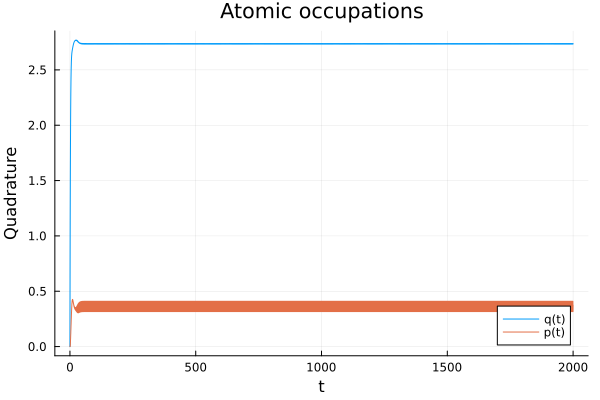

In [41]:
using Plots

# Extract time vector
t = sol.t
#v=convert_state.(sol.u)
v=sol.u
# --- Compute quadratures q(t) and p(t) ---
q= real.([u[1] for u in v])
p = real.([u[2] for u in v])   # real part of entry 9
plot(t, q, label="q(t)", xlabel="t", ylabel="Quadrature", title="Atomic occupations")
plot!(t, p, label="p(t)")




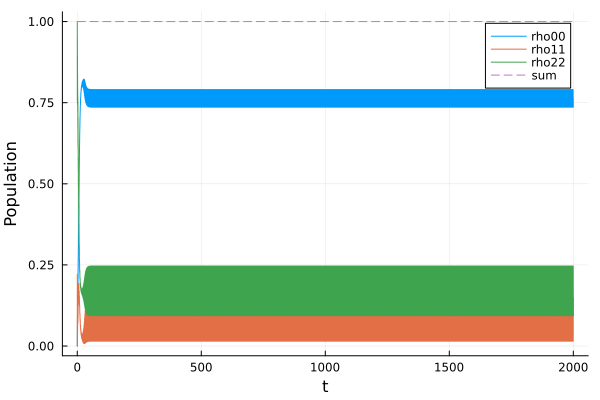

In [42]:
using Plots

# Compute populations ρ₀₀, ρ₁₁, ρ₂₂ and their sum from the ODE solution `sol`
t_vals = sol.t
N = length(t_vals)

# preallocate arrays
rho00 = zeros(Float64, N)
rho11 = zeros(Float64, N)
rho22 = zeros(Float64, N)
rho_sum = zeros(Float64, N)

for (i, u) in enumerate(sol.u)
    # unpack the state vector x = [Q, P, x1, x2, x3, x4, x5, x6, x7, x8]
    Q, P, x1, x2, x3, x4, x5, x6, x7, x8 = real.(u)

    # reconstruct diagonal elements
    sum00_11 = (2 + sqrt(3)*x8) / 3
    rho00[i] = (sum00_11 + x3) / 2
    rho11[i] = (sum00_11 - x3) / 2
    rho22[i] = 1 - rho00[i] - rho11[i]

    # check trace
    rho_sum[i] = rho00[i] + rho11[i] + rho22[i]
end

# Plot the three populations and their sum
plot(t_vals, rho00, label="rho00", xlabel="t", ylabel="Population", legend=:topright)
plot!(t_vals, rho11, label="rho11")
plot!(t_vals, rho22, label="rho22")
plot!(t_vals, rho_sum, label="sum", linestyle=:dash)




Plots für Rho code 

In [31]:
# using Plots

# # Extract time vector
# t = sol.t
# #v=convert_state.(sol.u)
# v=sol.u
# # --- Compute quadratures q(t) and p(t) ---
# rho_00 = real.([u[3] for u in v])
# rho_11 = real.([u[6] for u in v])   # real part of entry 9
# rho_22 = real.([u[7] for u in v])
# sum_rho = rho_00+rho_11+rho_22
# # Plot q and p in one diagram
# plot(t, rho_00, label="rho_00(t)", xlabel="t", ylabel="Quadrature", title="Atomic occupations")
# plot!(t, rho_11, label="rho_11(t)")
# plot!(t, rho_22, label="rho_22(t)")
# plot!(t, sum_rho, label="sum_rho(t)")


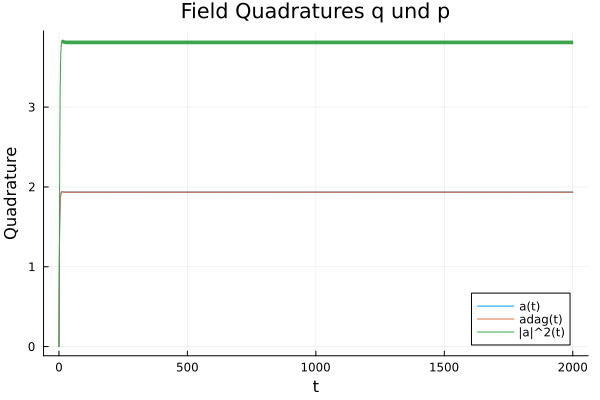

In [ ]:
# using Plots

# Extract time vector
# t = sol.t
# v=convert_state.(sol.u)

# --- Compute quadratures q(t) and p(t) ---
# a = real.([u[1] for u in sol.u])
# a_dag = real.([u[2] for u in sol.u])
# a_qudrat= abs2.(u[1] for u in sol.u)

# plot(t, a, label="a(t)", xlabel="t", ylabel="Quadrature", title="Field Quadratures q und p")
# plot!(t, a_dag, label="adag(t)")
# plot!(t, a_qudrat, label="|a|^2(t)")



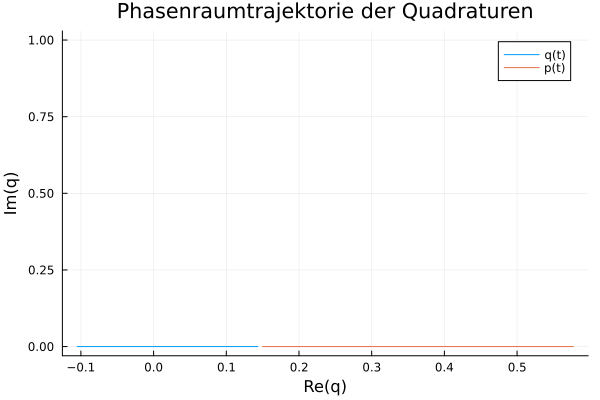

In [ ]:
# using Plots

# # --- Extract time and states ---
# t = sol.t
# v = convert_state.(sol.u)    # v[i] = (x1…x8, Q, P) at time t[i]

# # --- Build complex quadratures Q(t) and P(t) directly ---
# q_complex = [u[9] for u in v]   # Q is entry 9
# p_complex = [u[10] for u in v]  # P is entry 10

# # --- Plot phase‐space trajectory in the complex plane ---
# plot(
#     real.(q_complex), imag.(q_complex),
#     label = "q(t)",
#     xlabel = "Re(q)",
#     ylabel = "Im(q)",
#     title  = "Phasenraumtrajektorie der Quadraturen"
# )
# plot!(
#     real.(p_complex), imag.(p_complex),
#     label = "p(t)"
# )
